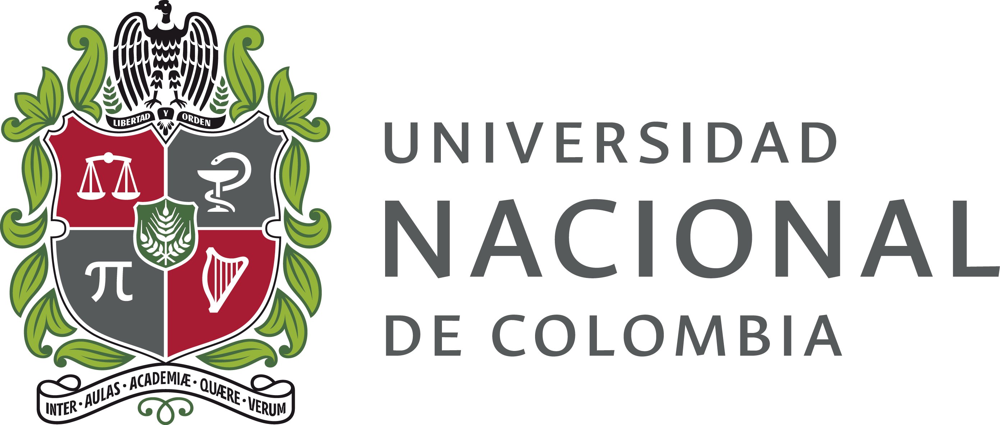
### **Universidad Nacional de Colombia sede Manizales**
#### Facultad de ingeniería y arquitectura
#### Departamento de ingeniería eléctrica, electrónica y computación
#### *Procesamiento digital de imágenes*

#### Profesor: Lucas Iturriago

## Transformaciones morfológicas

### 7.1 Fundamentos de las transformaciones morfológicas

Las **transformaciones morfológicas** son operaciones aplicadas sobre imágenes **binarias** o **en escala de grises** que permiten analizar, modificar o extraer características estructurales de los objetos presentes en ellas.
El término *morfológico* proviene precisamente de *morfología*, es decir, el estudio de la **forma y estructura** de los objetos.

A diferencia de los filtros lineales, que actúan principalmente sobre la **intensidad de los píxeles**, las transformaciones morfológicas se centran en **la geometría del objeto**, su **contorno**, **tamaño**, **conectividad** y **distribución espacial**.
Estas operaciones se definen matemáticamente en el campo de la **morfología matemática**, introducida originalmente por Jean Serra y Georges Matheron en los años 60 para el análisis de estructuras en imágenes geológicas, y hoy ampliamente utilizada en **visión por computador** y **procesamiento digital de imágenes**.

#### Principio básico

Toda operación morfológica se basa en la **interacción entre la imagen** y un **elemento estructurante** (también conocido como *kernel* o *structuring element*).
El kernel es una pequeña matriz (por ejemplo, de tamaño 3×3, 5×5 o 7×7) que define **la forma y el tamaño del vecindario** con el cual se procesan los píxeles.

En OpenCV, el kernel se crea mediante:

```python
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
```

La operación morfológica se aplica recorriendo la imagen píxel por píxel, tomando en cuenta los valores del vecindario definido por el kernel, para modificar la imagen según reglas geométricas como **erosionar, dilatar, abrir o cerrar** regiones.

#### Aplicaciones comunes

Las transformaciones morfológicas se utilizan en una amplia variedad de tareas de visión por computador, entre ellas:

* Eliminación de **ruido** en imágenes binarias.
* **Relleno** de huecos o discontinuidades.
* **Detección de bordes** o contornos estructurales.
* **Separación de objetos** conectados o agrupados.
* **Postprocesamiento** de resultados de segmentación semántica o por umbral.

En conjunto, proporcionan un conjunto de herramientas esenciales para el **análisis estructural y limpieza de imágenes**, constituyendo un paso intermedio habitual entre la **segmentación inicial** y la **extracción de características**.

### 7.2 Erosión (Erosion)

La **erosión** es la operación morfológica más básica.
Su objetivo es **reducir** las regiones blancas (*foreground*) de una imagen binaria, eliminando píxeles de los bordes de los objetos.

En términos simples:

> **La erosión “adelgaza” los objetos blancos** en la imagen.

Matemáticamente, consiste en “deslizar” un **elemento estructurante** sobre la imagen.
Un píxel en la salida será blanco (`1`) **solo si todos los píxeles bajo el kernel también son blancos** en la imagen original.

Esto equivale a una operación **mínimo local** dentro del vecindario del kernel.

#### Ejemplo de implementación

In [1]:
# @title
import os
import requests

# Carpeta de destino
dest_dir = "imagenes_pdi_clase4"
os.makedirs(dest_dir, exist_ok=True)

# Lista de archivos con su URL raw en GitHub
image_urls = {
    "circles.png": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/circles.png",
    "clock2.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/clock2.jpg",
    "einstein.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/einstein.jpg",
    "fingerprint.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/fingerprint.jpg",
    "horse-dog.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/horse-dog.jpg",
    "lena.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/lena.jpg",
    "mandrill_spnoise_0.1.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/mandrill_spnoise_0.1.jpg",
    "squirrel.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/squirrel.jpg",
    "tagore.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/tagore.jpg",
    "zebras.jpg": "https://raw.githubusercontent.com/UN-GCPDS/ProcesamientoDigitalImagenes/main/Clase%204/Figuras/zebras.jpg"
}

def download_file(url, dest_path, chunk_size=8192, timeout=30):
    try:
        with requests.get(url, stream=True, timeout=timeout) as r:
            r.raise_for_status()
            with open(dest_path, "wb") as f:
                for chunk in r.iter_content(chunk_size=chunk_size):
                    if chunk:  # filtra keep-alive chunks
                        f.write(chunk)
        return True, None
    except Exception as e:
        return False, str(e)

results = {}
for fname, url in image_urls.items():
    out_path = os.path.join(dest_dir, fname)
    ok, err = download_file(url, out_path)
    results[fname] = "OK" if ok else f"ERROR: {err}"

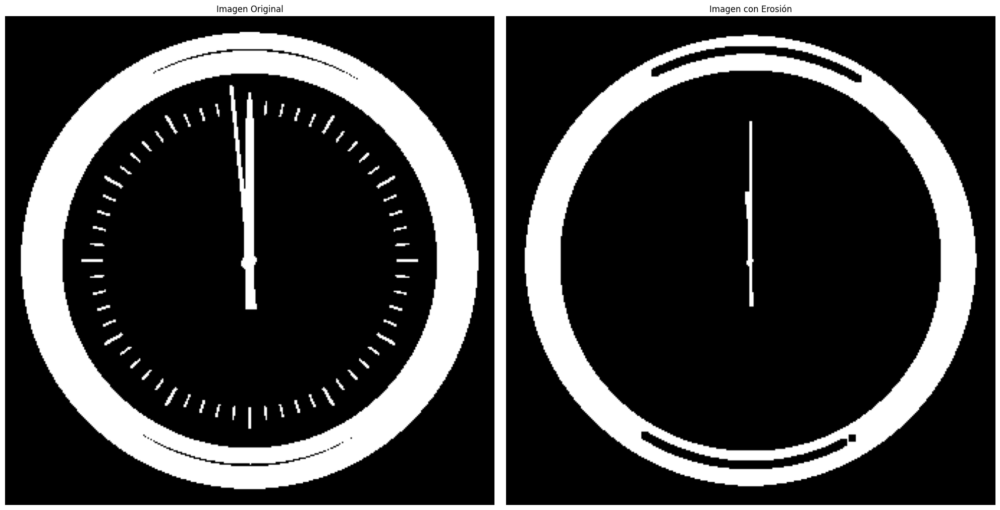

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

img = cv2.imread("imagenes_pdi_clase4/clock2.jpg", cv2.IMREAD_GRAYSCALE) / 255
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Crear un kernel 5x5 para la operación morfológica
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))  # (tipo de forma rectangular, tamaño del kernel)

# Aplicar erosión morfológica
erosion = cv2.erode(img, kernel, iterations=1)  # (imagen origen, elemento estructurante, número de iteraciones)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(erosion, cmap='gray')
axs[1].set_title('Imagen con Erosión')
axs[1].axis('off')

plt.tight_layout()
plt.show()

Ejemplo con kernel elíptico y más iteraciones:

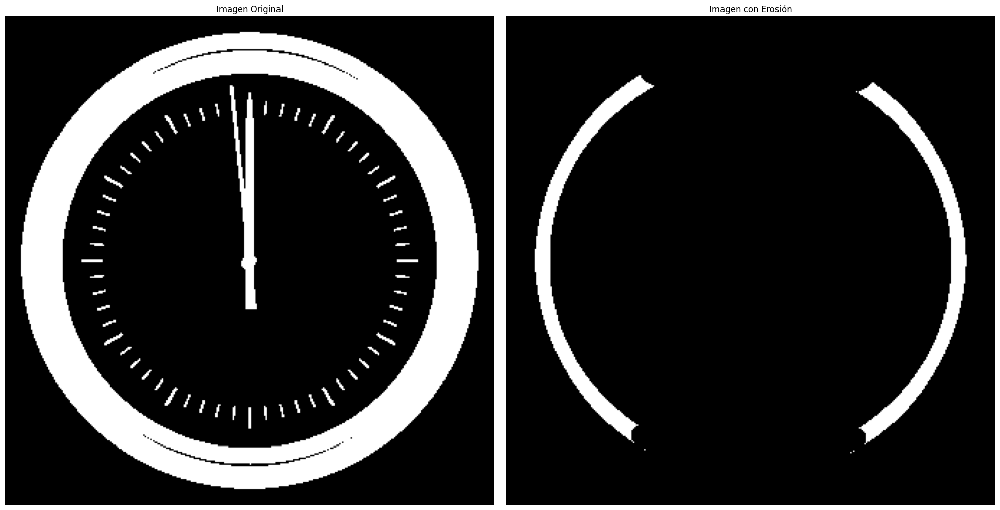

In [3]:
img = cv2.imread("imagenes_pdi_clase4/clock2.jpg", cv2.IMREAD_GRAYSCALE) / 255
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7))
erosion2 = cv2.erode(img, kernel2, iterations=3)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(erosion2, cmap='gray')
axs[1].set_title('Imagen con Erosión')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* Eliminación de **ruido blanco** aislado.
* Separar objetos que están **ligeramente conectados**.
* Reducir el tamaño de regiones antes de aplicar **detección de contornos**.

### 7.3 Dilatación (Dilation)

La **dilatación** es la operación morfológica **complementaria** a la erosión.
Su objetivo es **expandir** las regiones blancas (*foreground*) de una imagen binaria, añadiendo píxeles en los bordes de los objetos.

En términos simples:

> **La dilatación “engorda” los objetos blancos** en la imagen.

Matemáticamente, consiste en “deslizar” un **elemento estructurante** sobre la imagen.
Un píxel en la salida será blanco (`1`) **si al menos un píxel bajo el kernel es blanco** en la imagen original.

Esto equivale a una operación **máximo local** dentro del vecindario definido por el kernel.

#### Ejemplo de implementación

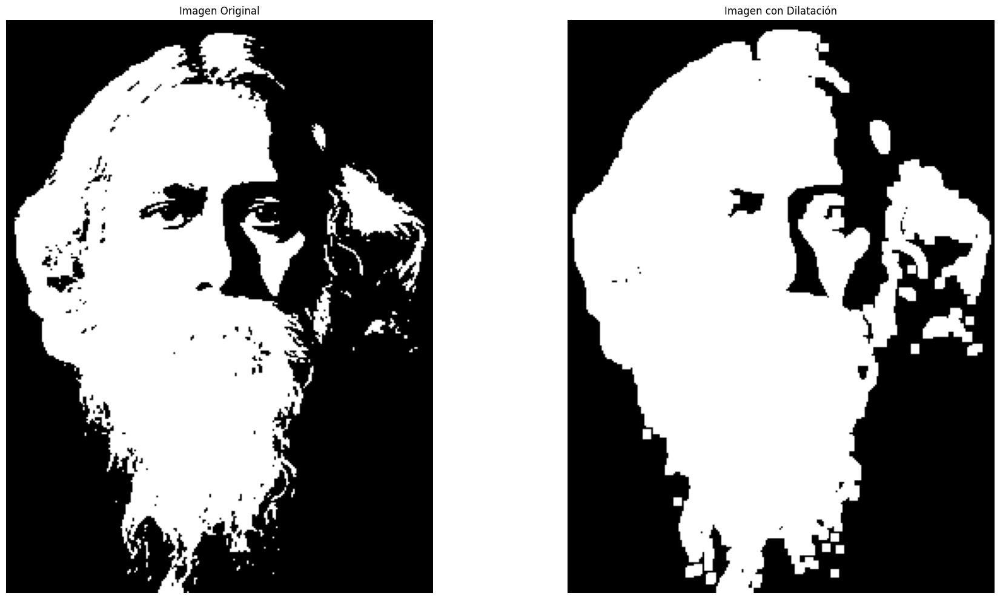

In [4]:
img = cv2.imread("imagenes_pdi_clase4/tagore.jpg", cv2.IMREAD_GRAYSCALE) / 255
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Crear un kernel 5x5
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))

# Aplicar dilatación
dilation = cv2.dilate(img, kernel, iterations=1)

fig, axs = plt.subplots(1,2,figsize=(20,10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(dilation, cmap='gray')
axs[1].set_title('Imagen con Dilatación')
axs[1].axis('off')

plt.tight_layout()
plt.show()

Ejemplo con kernel elíptico y más iteraciones:

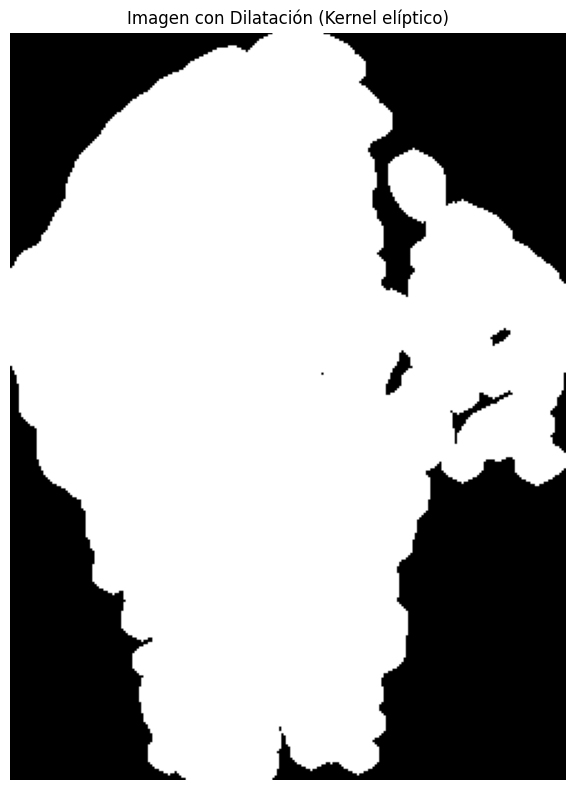

In [5]:
kernel2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7))
dilation2 = cv2.dilate(img, kernel2, iterations=3)

fig = plt.figure(figsize=(17,8))

plt.imshow(dilation2, cmap='gray')
plt.title('Imagen con Dilatación (Kernel elíptico)')
plt.axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* **Rellenar pequeños agujeros** en regiones blancas.
* Unir objetos que están **cercanos pero no conectados**.
* Aumentar regiones de interés antes de operaciones de segmentación o contorno.
* Preprocesamiento en segmentación clásica (por umbral o color).

### 7.4 Apertura (Opening)

La **apertura** (*Opening*) es una **composición de dos operaciones morfológicas** aplicadas en secuencia:

> **Erosión seguida de dilatación.**

Matemáticamente:
$$
A \circ B = (A \ominus B) \oplus B
$$
donde

* ( A ) es la imagen original.
* ( B ) es el elemento estructurante.
* ( $\ominus$ ) es la erosión.
* ( $\oplus$ ) es la dilatación.
*

Efecto general

* **Suaviza** los contornos de los objetos.
* **Rompe conexiones finas** entre objetos cercanos.
* **Elimina ruido brillante** (píxeles blancos aislados) sobre fondo negro.

#### Ejemplo de implementación

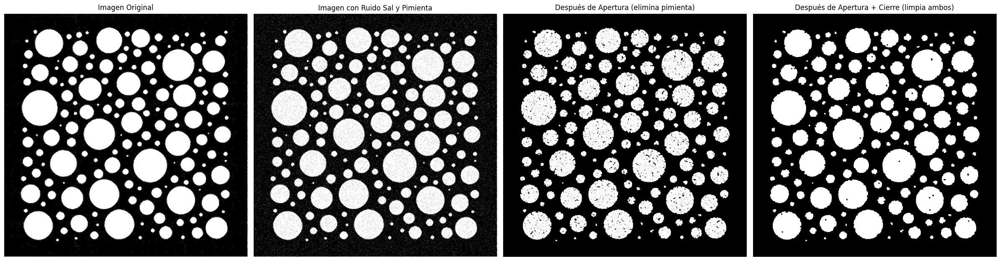

In [6]:
# Leer la imagen en escala de grises
img = cv2.imread("imagenes_pdi_clase4/circles.png", cv2.IMREAD_GRAYSCALE)
img = np.where(img > 0.5, 1, 0).astype(np.uint8) * 255  # Binarizar

# Parámetro: proporción de píxeles con ruido
prob = 0.05  # 5% del total de píxeles tendrán ruido

# Copiar imagen
img_ruidosa = img.copy()

# Generar coordenadas aleatorias para ruido "sal" (blanco)
num_sal = int(prob * img.size / 2)
coords_sal = (
    np.random.randint(0, img.shape[0], num_sal),
    np.random.randint(0, img.shape[1], num_sal)
)
img_ruidosa[coords_sal] = 255

# Generar coordenadas aleatorias para ruido "pimienta" (negro)
num_pimienta = int(prob * img.size / 2)
coords_pimienta = (
    np.random.randint(0, img.shape[0], num_pimienta),
    np.random.randint(0, img.shape[1], num_pimienta)
)
img_ruidosa[coords_pimienta] = 0

# Kernel estructurante
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))

# Aplicar apertura para eliminar ruido de tipo "pimienta"
apertura = cv2.morphologyEx(img_ruidosa, cv2.MORPH_OPEN, kernel)

# Aplicar cierre para eliminar ruido de tipo "sal"
cierre = cv2.morphologyEx(apertura, cv2.MORPH_CLOSE, kernel)

# Mostrar resultados
fig, axs = plt.subplots(1, 4, figsize=(24, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(img_ruidosa, cmap='gray')
axs[1].set_title('Imagen con Ruido Sal y Pimienta')
axs[1].axis('off')

axs[2].imshow(apertura, cmap='gray')
axs[2].set_title('Después de Apertura (elimina pimienta)')
axs[2].axis('off')

axs[3].imshow(cierre, cmap='gray')
axs[3].set_title('Después de Apertura + Cierre (limpia ambos)')
axs[3].axis('off')

plt.tight_layout()
plt.show()

### Casos de uso

* Eliminación de **ruido puntual** o píxeles blancos aislados.
* Limpieza de **máscaras binarias** antes del análisis de contornos.
* Preprocesamiento antes de **detección de bordes** o **segmentación**.

### 7.5 Cierre (Closing)

La **cierre** (*Closing*) es la **operación morfológica inversa** a la apertura.
Consiste en aplicar primero una **dilatación** y luego una **erosión**.

Matemáticamente:
$$
A \bullet B = (A \oplus B) \ominus B
$$
donde:

* ( A ) es la imagen original,
* ( B ) es el elemento estructurante,
* ( $\oplus$ ) representa la dilatación,
* ( $\ominus$ ) representa la erosión.

Efecto general

* **Une** regiones blancas cercanas.
* **Rellena agujeros oscuros** pequeños en regiones blancas.
* **Suaviza contornos** de objetos segmentados.

En contraste con la apertura, el cierre **preserva las regiones brillantes** y elimina pequeños puntos **oscuros**.

#### Ejemplo implementación

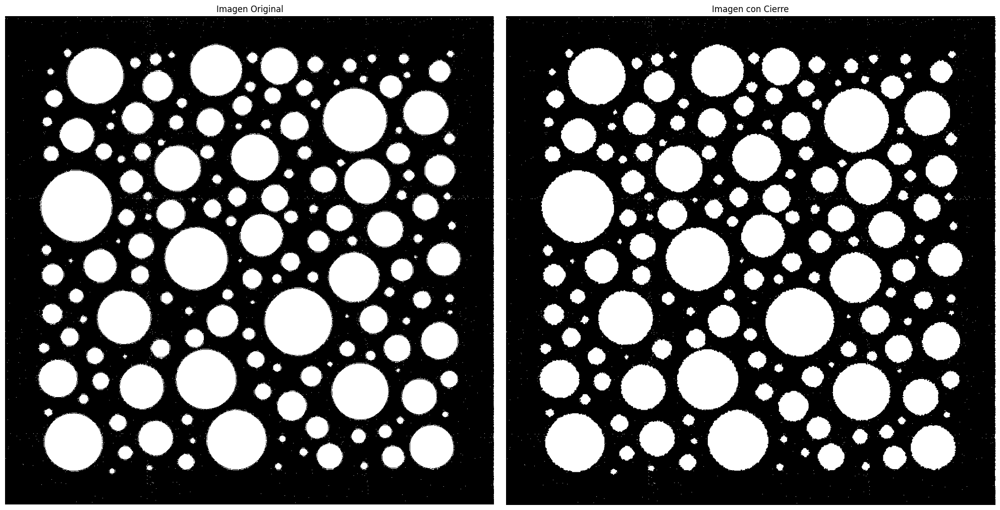

In [7]:
img = cv2.imread("imagenes_pdi_clase4/circles.png", cv2.IMREAD_GRAYSCALE)
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Crear kernel estructurante
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))

# Aplicar cierre
cierre = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(cierre, cmap='gray')
axs[1].set_title('Imagen con Cierre')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* Rellenar **pequeños huecos o discontinuidades** dentro de regiones detectadas.
* Mejorar **máscaras de segmentación** tras umbralización.
* Suavizar **bordes irregulares** tras operaciones binarias.

### 7.6 Gradiente Morfológico (Morphological Gradient)

El **gradiente morfológico** es una operación que **resalta los bordes** de los objetos en una imagen binaria o en escala de grises.
Se obtiene como la **diferencia entre la dilatación y la erosión** de una misma imagen.

$$
G = (A \oplus B) - (A \ominus B)
$$

donde:

* ( A ) = imagen original
* ( B ) = elemento estructurante
* ( $\oplus$ ) = dilatación
* ( $\ominus$ ) = erosión

#### Tipos de gradiente morfológico

1. **Gradiente externo**:
   $$
   G_{ext} = (A \oplus B) - A
   $$
   Resalta el **borde externo** del objeto.

2. **Gradiente interno**:
   $$
   G_{int} = A - (A \ominus B)
   $$
   Resalta el **borde interno**.

3. **Gradiente clásico (o completo)**:
   $$
   G = (A \oplus B) - (A \ominus B)
   $$
   Incluye ambos bordes.

#### Ejemplo de implementación

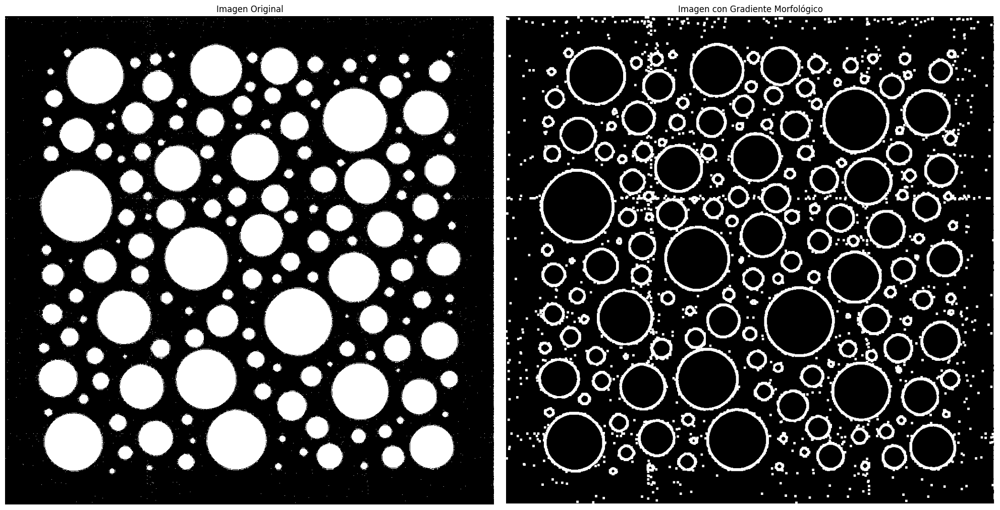

In [8]:
img = cv2.imread("imagenes_pdi_clase4/circles.png", cv2.IMREAD_GRAYSCALE)
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Elemento estructurante para la operación morfológica
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))

# Aplicar gradiente morfológico (diferencia entre dilatación y erosión)
gradiente = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(gradiente, cmap='gray')
axs[1].set_title('Imagen con Gradiente Morfológico')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* **Detección de bordes suaves o binarios** sin depender de gradientes de intensidad (como Sobel o Canny).
* **Preprocesamiento en segmentación**, para aislar contornos de regiones.
* **Resaltado de fronteras** entre objetos y fondo.

### 7.7 Top-Hat (White Top-Hat Transform)

El **Top-Hat morfológico** (también llamado **White Top-Hat**) es una operación que **extrae los elementos brillantes o más claros** que son **más pequeños que el elemento estructurante** del fondo de una imagen.

Matemáticamente se define como:

$$
T = A - (A \circ B)
$$

donde:

* ( A ) = imagen original
* ( B ) = elemento estructurante
* ( $\circ$ ) = apertura morfológica (erosión seguida de dilatación)

#### Ejemplo de implementación

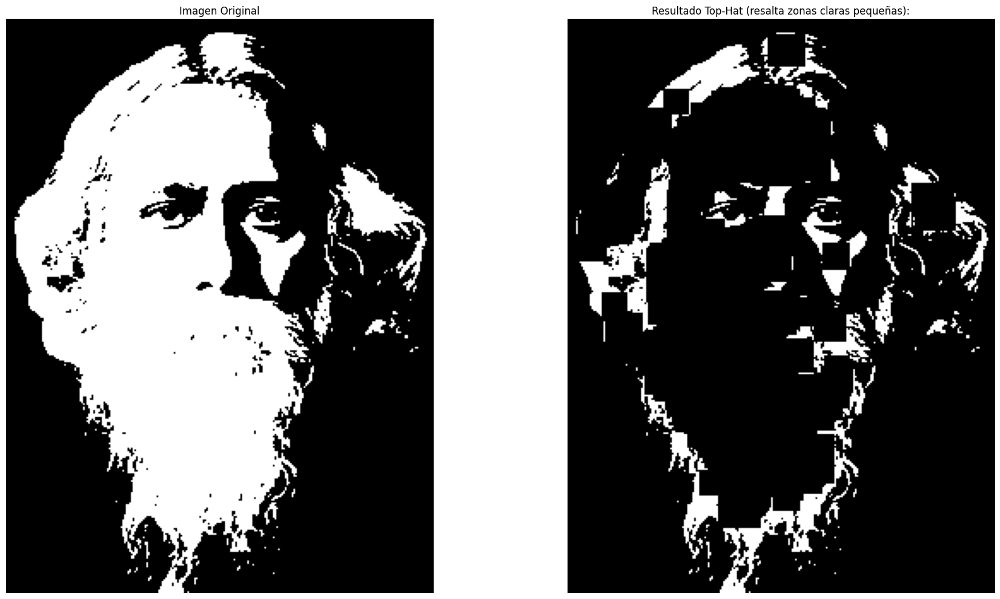

In [9]:
img = cv2.imread("imagenes_pdi_clase4/tagore.jpg", cv2.IMREAD_GRAYSCALE) / 255
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Elemento estructurante grande para detectar zonas claras
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (15,15))  # Kernel más grande para operación Top-Hat

# Aplicar transformación Top-Hat (diferencia entre imagen original y apertura)
tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(tophat, cmap='gray')
axs[1].set_title('Resultado Top-Hat (resalta zonas claras pequeñas):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* **Corrección de iluminación no uniforme**: al eliminar fondo suave y dejar solo detalles brillantes.
* **Detección de defectos claros** en inspección industrial.
* **Mejora de microdetalles** en imágenes médicas o microscópicas.
* **Preprocesamiento para binarización adaptativa**.

### 7.8 Black-Hat (Black Top-Hat Transform)

El **Black-Hat morfológico** (también conocido como **Black Top-Hat**) es la operación complementaria al Top-Hat.
Sirve para **resaltar las regiones oscuras pequeñas** sobre un **fondo más claro**.

Matemáticamente se define como:

$$
B = (A \bullet B) - A
$$

donde:

* ( A ) = imagen original
* ( B ) = elemento estructurante
* ( $\bullet$ ) = cierre morfológico (dilatación seguida de erosión)

#### Ejemplo de implementación

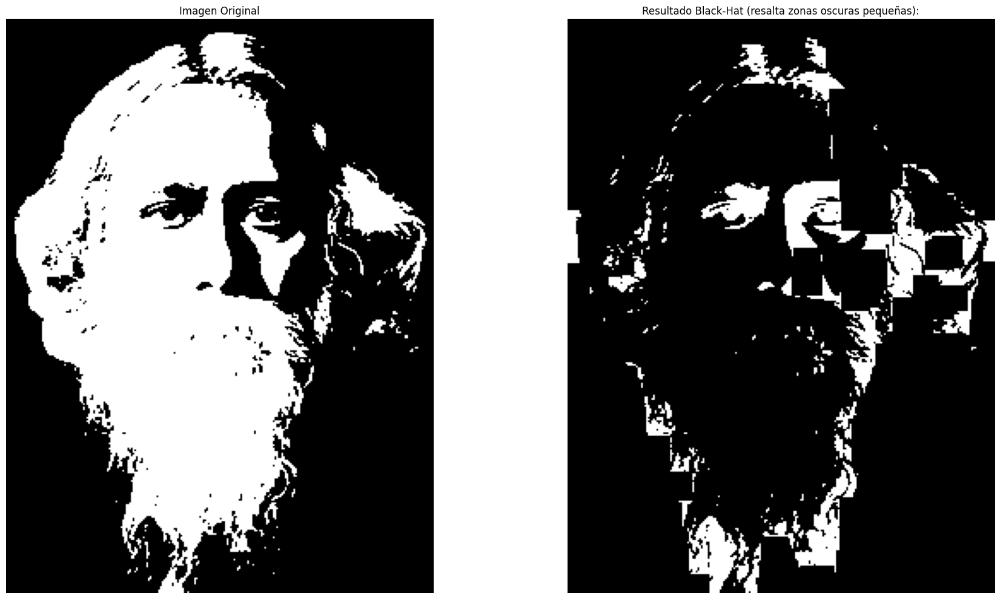

In [10]:
img = cv2.imread("imagenes_pdi_clase4/tagore.jpg", cv2.IMREAD_GRAYSCALE) / 255
img = np.where(img>0.5,1,0).astype(np.uint8) * 255

# Elemento estructurante grande para detectar zonas oscuras
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (15,15))

# Aplicar transformación Black-Hat (diferencia entre cierre e imagen original)
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen Original')
axs[0].axis('off')

axs[1].imshow(blackhat, cmap='gray')
axs[1].set_title('Resultado Black-Hat (resalta zonas oscuras pequeñas):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### Casos de uso

* **Detección de sombras o imperfecciones oscuras** en superficies.
* **Realce de arrugas, venas o grietas** en imágenes biomédicas o materiales.
* **Corrección de iluminación desigual** junto con Top-Hat.
* **Preprocesamiento de imágenes de texto** para mejorar contraste local.

## Filtros

### 8.1 ¿Qué es un filtro?

Un **filtro** en procesamiento de imágenes es una operación que **modifica los valores de los píxeles** de una imagen con el fin de **resaltar o suprimir determinadas características**.

Los filtros pueden:

* **Reducir ruido** (suavizado o *smoothing*).
* **Realzar bordes o detalles** (*sharpening*).
* **Detectar estructuras geométricas**, como líneas o contornos.
* **Transformar** la imagen para facilitar tareas posteriores (como segmentación o reconocimiento).

En términos matemáticos, un filtro espacial opera sobre cada píxel considerando su **vecindario**, normalmente definido por una pequeña **matriz o kernel**.

#### Filtros espaciales vs filtros frecuenciales

| Tipo de filtro  | Dominios                              | Operación principal                                     | Ejemplo                                |
| --------------- | ------------------------------------- | ------------------------------------------------------- | -------------------------------------- |
| **Espacial**    | Imagen (espacio de píxeles)           | Convolución directa con un kernel                       | Blur, Sobel, Canny                     |
| **Frecuencial** | Transformada (espacio de frecuencias) | Multiplicación con una máscara en el dominio de Fourier | Filtros pasa-bajas o pasa-altas en FFT |

En esta clase trabajaremos principalmente con **filtros espaciales**, implementados en OpenCV mediante **kernels** y **convoluciones**.

#### Convolución: la operación clave

La **convolución** es el núcleo del filtrado espacial.
Consiste en recorrer la imagen con un **kernel** (una pequeña matriz) y, para cada píxel, calcular la suma ponderada de sus vecinos.

$$
g(x, y) = \sum_{i=-k}^{k} \sum_{j=-k}^{k} f(x+i, y+j) \cdot h(i, j)
$$

donde:

* ( f(x, y) ) es la imagen original,
* ( h(i, j) ) es el kernel,
* ( g(x, y) ) es la imagen filtrada.

#### Ejemplo de implementación

Un kernel de suavizado 3×3 (filtro promedio):

$$
\frac{1}{9}
\begin{bmatrix}
1 & 1 & 1 \\
1 & 1 & 1 \\
1 & 1 & 1
\end{bmatrix}
$$

aplicado sobre una región de la imagen reemplaza cada píxel por el **promedio de sus vecinos**, reduciendo variaciones abruptas (ruido o bordes).

#### Ejemplo de implementación

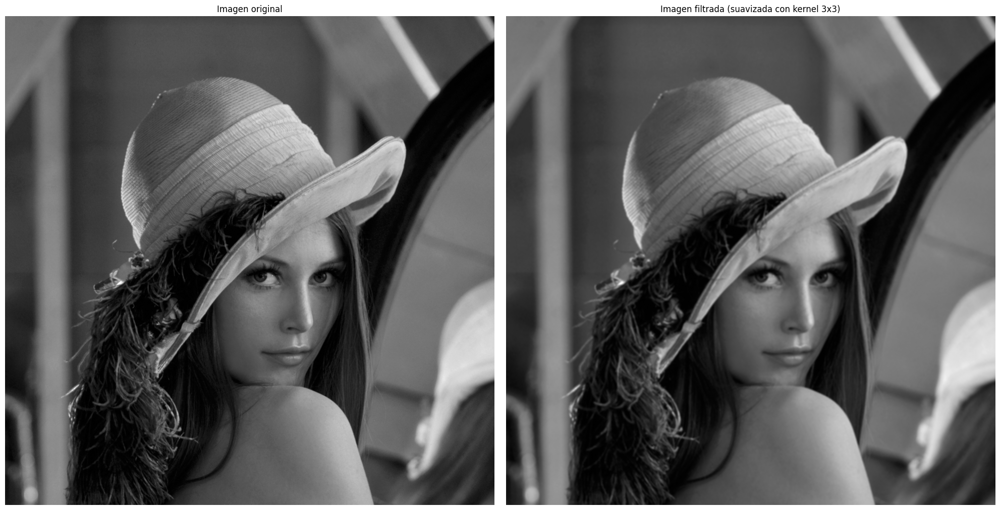

In [11]:
# Cargar imagen en escala de grises
img = cv2.imread(cv2.samples.findFile("imagenes_pdi_clase4/lena.jpg"), cv2.IMREAD_GRAYSCALE)  # Cargar como imagen monocromática

# Crear kernel de suavizado 3x3
kernel = np.ones((8,8), np.float32) / 64  # Matriz 3x3 normalizada (suma = 1) para promedio

# Aplicar convolución con filtro personalizado
dst = cv2.filter2D(img, -1, kernel)  # (imagen, profundidad de salida=-1:misma que entrada, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(dst, cmap='gray')
axs[1].set_title('Imagen filtrada (suavizada con kernel 3x3)')
axs[1].axis('off')

plt.tight_layout()
plt.show()

### 8.2 Convolución y kernels

#### ¿Qué es un *kernel*?

Un **kernel** (también llamado **máscara** o **filtro**) es una **pequeña matriz numérica** que define cómo se transformará cada píxel de una imagen en función de sus vecinos.

Cada valor del kernel actúa como un **peso** aplicado a los píxeles del vecindario.
Luego, la suma ponderada de esos valores reemplaza al píxel central.

En otras palabras, un kernel controla **qué tan importante es cada píxel vecino** en el cálculo del nuevo valor.

#### Ejemplo de implementación

Una imagen como una cuadrícula de números (intensidades de gris).
El kernel se desliza sobre esta cuadrícula y calcula la **suma ponderada** de los valores locales.

Ejemplo, si se usa el kernel:

$$
K = \frac{1}{9}
\begin{bmatrix}
1 & 1 & 1 \\
1 & 1 & 1 \\
1 & 1 & 1 \\
\end{bmatrix}
$$

Cada píxel se reemplaza por el **promedio** de sus 9 vecinos → se obtiene un efecto de **suavizado**.

Kernel de realce (sharpening)

Un kernel de realce busca **resaltar bordes** aumentando las diferencias locales.

$$
K =
\begin{bmatrix}
0 & -1 & 0 \\
-1 & 5 & -1 \\
0 & -1 & 0 \\
\end{bmatrix}
$$

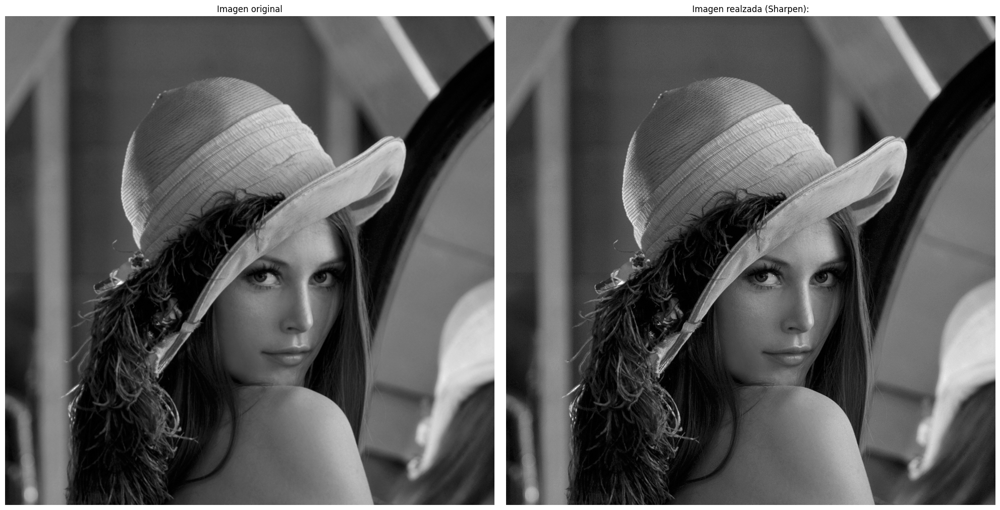

In [12]:
# Kernel de realce
kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 5, -1],
                           [0, -1, 0]])

sharpened = cv2.filter2D(img, -1, kernel_sharpen)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(sharpened, cmap='gray')
axs[1].set_title('Imagen realzada (Sharpen):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

### 8.3 Filtros de suavizado (reducción de ruido)

El **suavizado** (o *smoothing*) es una técnica que busca **reducir el ruido** y las **variaciones bruscas de intensidad** en una imagen.
Su objetivo es conservar la estructura global mientras elimina irregularidades locales causadas por sensores, iluminación o compresión.

Estos filtros se basan en **promedios locales** o **ponderaciones de vecindarios**.
En términos de convolución, aplican **kernels que difuminan** la imagen, suavizando transiciones entre píxeles.

### Tipos de filtros de suavizado en OpenCV

#### 1. Filtro de promedio — `cv2.blur()`

Aplica una media simple en una ventana ( k \times k ) alrededor de cada píxel.
Cada píxel se reemplaza por el **promedio aritmético** de sus vecinos.

$$
I'(x,y) = \frac{1}{k^2} \sum_{i=-a}^{a} \sum_{j=-b}^{b} I(x+i, y+j)
$$

##### Ejemplo de implementación

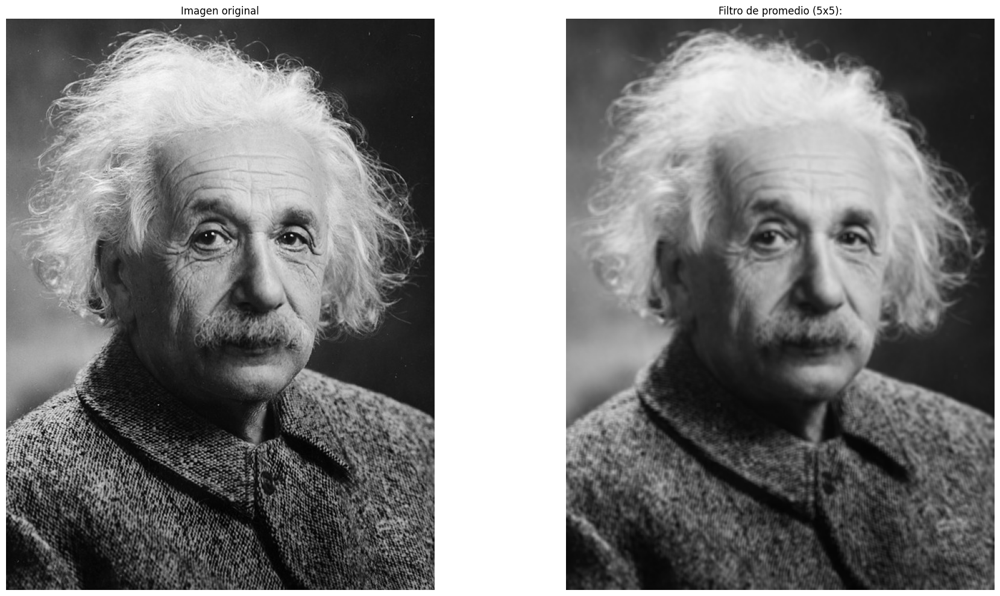

In [13]:
img = cv2.imread(cv2.samples.findFile("imagenes_pdi_clase4/einstein.jpg"))

blur = cv2.blur(img, (5,5)) # (imagen, tamaño del kernel)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(blur, cv2.COLOR_BGR2RGB))
axs[1].set_title('Filtro de promedio (5x5):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 2. Filtro Gaussiano — `cv2.GaussianBlur()`

Aplica un **promedio ponderado** donde los píxeles cercanos al centro tienen **mayor peso** según una distribución **gaussiana**.

$$
G(x,y) = \frac{1}{2\pi\sigma^2} e^{-\frac{x^2 + y^2}{2\sigma^2}}
$$

El parámetro `sigmaX` controla la extensión del suavizado.

##### Ejemplo de implementación

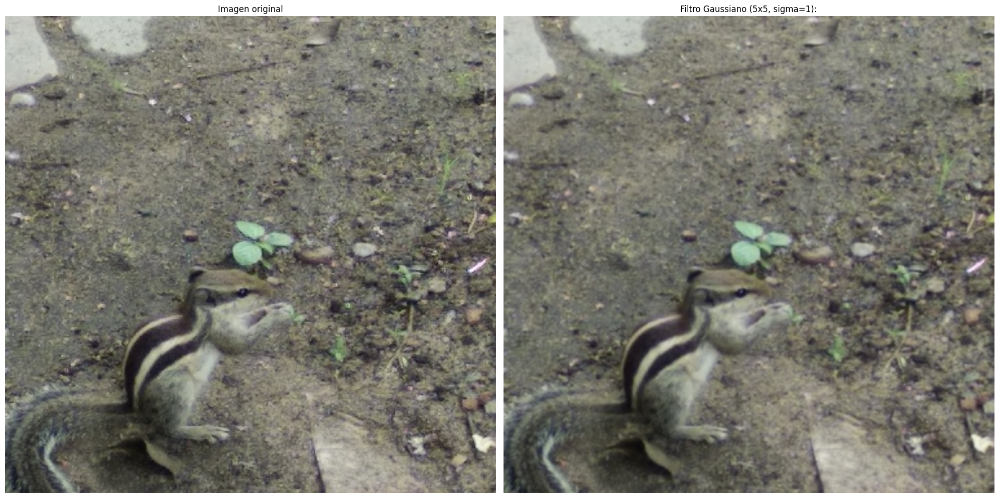

In [23]:
img = cv2.imread(cv2.samples.findFile("/content/imagenes_pdi_clase4/squirrel.jpg"))

gaussian = cv2.GaussianBlur(img, (5,5), 1) # (imagen, tamaño del kernel (impar), sigma)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(gaussian, cv2.COLOR_BGR2RGB))
axs[1].set_title('Filtro Gaussiano (5x5, sigma=1):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 3. Filtro de mediana — `cv2.medianBlur()`

Reemplaza cada píxel por la **mediana** de los valores en su vecindario.
No realiza promedio: selecciona el valor **central** tras ordenar los vecinos.

##### Ejemplo de implementación

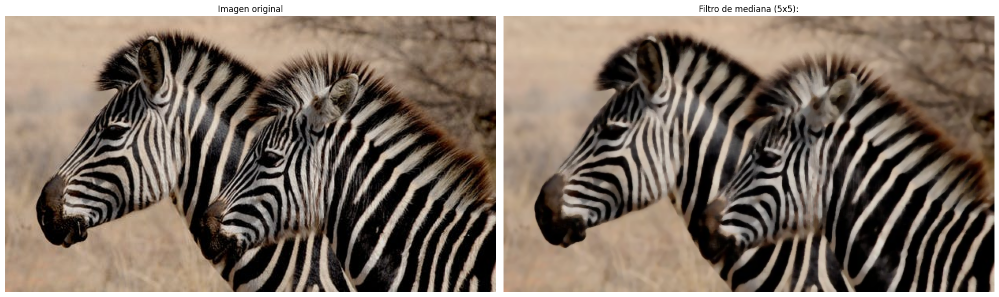

In [24]:
img = cv2.imread(cv2.samples.findFile("imagenes_pdi_clase4/zebras.jpg"))

median = cv2.medianBlur(img, 5) # (imagen, tamaño del kernel (impar))

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(median, cv2.COLOR_BGR2RGB))
axs[1].set_title('Filtro de mediana (5x5):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 4. Filtro bilateral — `cv2.bilateralFilter()`

Aplica un suavizado **no lineal** que combina **distancia espacial** y **diferencia de intensidad**.
De esta forma, **preserva bordes** mientras reduce el ruido.

$$
I'(p) = \frac{1}{W_p} \sum_{q \in \Omega} G_s(|p-q|) , G_r(|I(p)-I(q)|) , I(q)
$$

donde (G_s) es la función gaussiana espacial y (G_r) la gaussiana de rango (diferencia de color).

##### Ejemplo de implementación

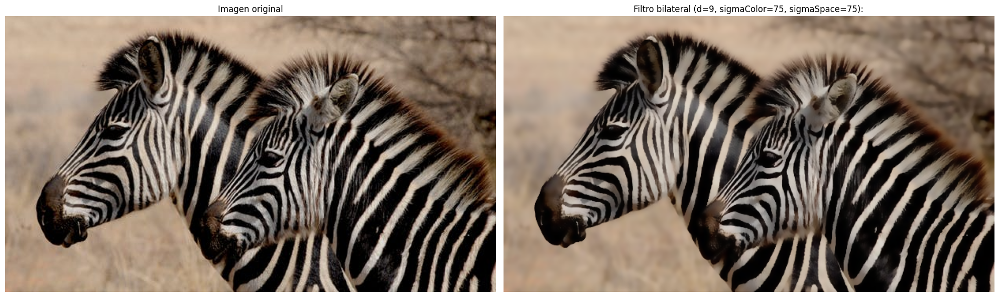

In [16]:
bilateral = cv2.bilateralFilter(img, 9, 75, 75) # (imagen, diámetro del píxel, sigmaColor, sigmaSpace)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(bilateral, cv2.COLOR_BGR2RGB))
axs[1].set_title('Filtro bilateral (d=9, sigmaColor=75, sigmaSpace=75):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

### 8.4 Filtros de realce y detección de bordes

Los **filtros de realce** y **detección de bordes** buscan resaltar los cambios abruptos en la intensidad de la imagen, es decir, las **transiciones entre objetos o regiones**.
Estas operaciones son clave en tareas de **segmentación**, **detección de contornos** y **reconocimiento de patrones**.

Mientras los filtros de suavizado eliminan ruido y detalles, estos **acentúan los detalles locales**.

### Principales métodos de realce y detección de bordes

#### 1. Filtro de Sobel — `cv2.Sobel()`

El filtro **Sobel** calcula la **derivada de la intensidad** en direcciones (x) y (y).
Detecta bordes horizontales, verticales o diagonales según el eje analizado.

$$
G_x =
\begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1 \\
\end{bmatrix},
\quad
G_y =
\begin{bmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1 \\
\end{bmatrix}
$$

$$
G = \sqrt{G_x^2 + G_y^2}
$$

##### Ejemplo de implementación

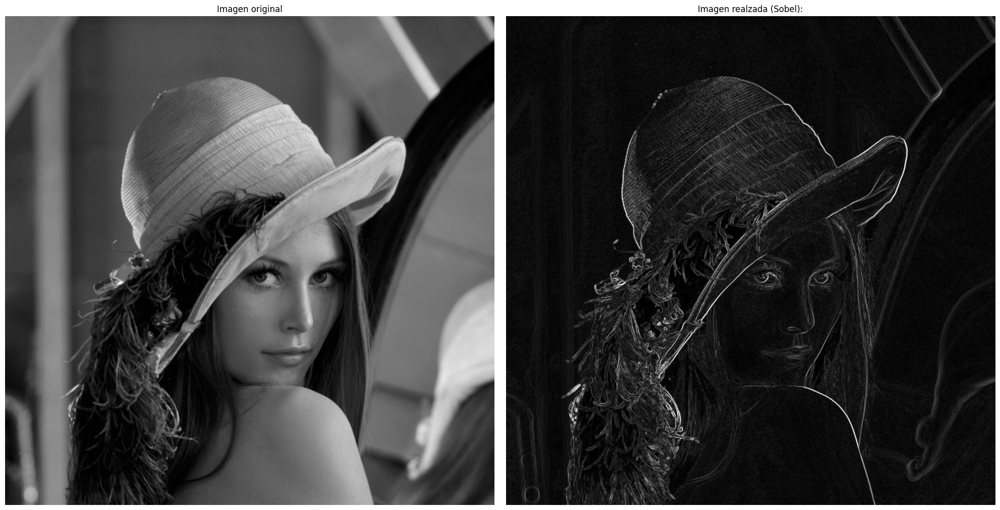

In [17]:
img = cv2.imread(cv2.samples.findFile("/content/imagenes_pdi_clase4/lena.jpg"), cv2.IMREAD_GRAYSCALE)

# Derivadas en X e Y
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3) # (imagen, profundidad de salida, derivada en x, derivada en y, tamaño del kernel)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)

# Magnitud del gradiente
sobel = cv2.magnitude(sobelx, sobely) # Magnitud del gradiente

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.convertScaleAbs(sobel), cmap='gray')
axs[1].set_title('Imagen realzada (Sobel):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 2. Filtro de Scharr — `cv2.Scharr()`

Una versión mejorada del Sobel, optimizada para **mayor precisión** en gradientes pequeños.
Usa kernels con **pesos más altos**, lo que da bordes más definidos.

$$
G_x =
\begin{bmatrix}
-3 & 0 & 3 \\
-10 & 0 & 10 \\
-3 & 0 & 3 \\
\end{bmatrix}
$$

##### Ejemplo de implementación

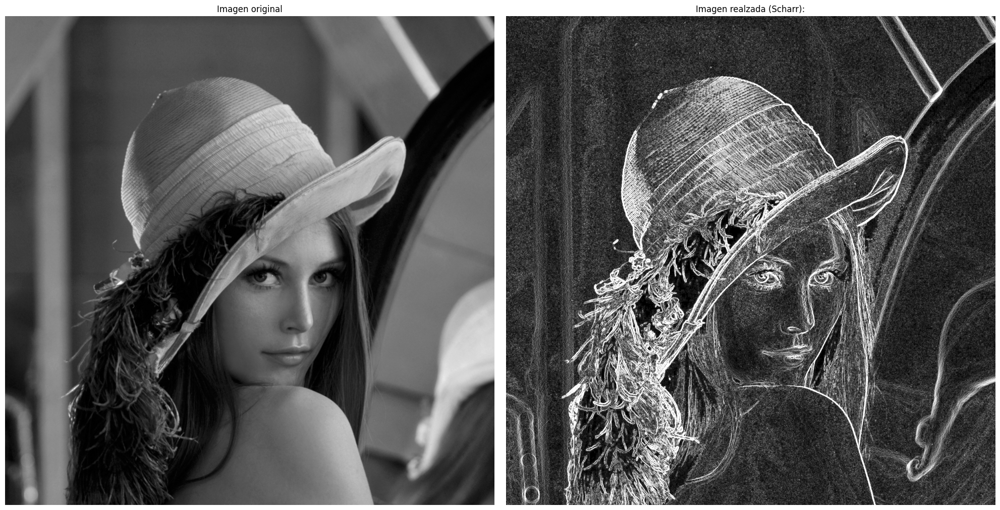

In [18]:
scharrx = cv2.Scharr(img, cv2.CV_64F, 1, 0) # (imagen, profundidad de salida, derivada en x, derivada en y)
scharry = cv2.Scharr(img, cv2.CV_64F, 0, 1)
scharr = cv2.magnitude(scharrx, scharry)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.convertScaleAbs(scharr), cmap='gray')
axs[1].set_title('Imagen realzada (Scharr):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 3. Filtro Laplaciano — `cv2.Laplacian()`

Calcula la **segunda derivada** de la imagen.
A diferencia del Sobel, el Laplaciano **no tiene dirección**: detecta bordes en todas las orientaciones.

$$
\nabla^2 f = \frac{\partial^2 f}{\partial x^2} + \frac{\partial^2 f}{\partial y^2}
$$

Kernel típico:

$$
\begin{bmatrix}
0 & 1 & 0 \\
1 & -4 & 1 \\
0 & 1 & 0 \\
\end{bmatrix}
$$

##### Ejemplo de implementación

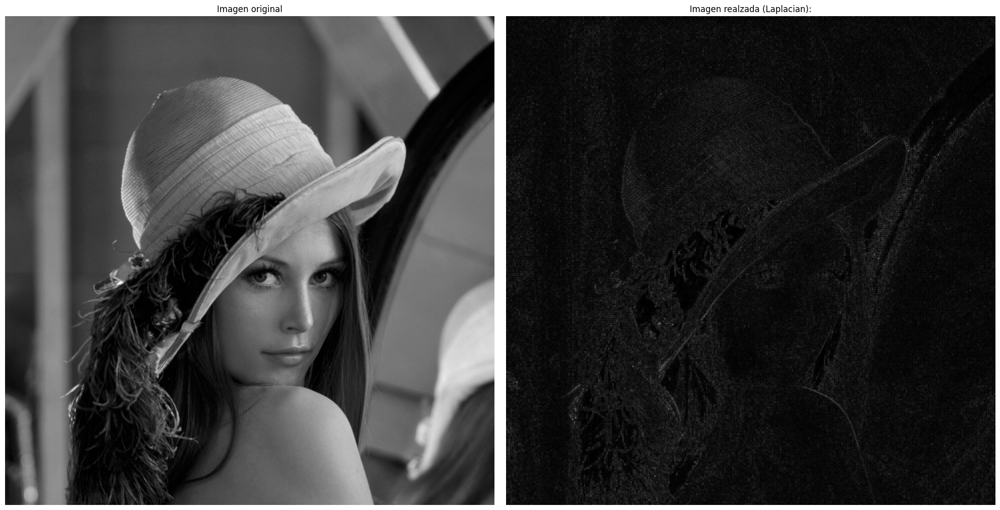

In [19]:
laplacian = cv2.Laplacian(img, cv2.CV_64F) # (imagen, profundidad de salida)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(cv2.convertScaleAbs(laplacian), cmap='gray')
axs[1].set_title('Imagen realzada (Laplacian):')
axs[1].axis('off')

plt.tight_layout()
plt.show()

#### 4. Detector de bordes Canny — `cv2.Canny()`

El **algoritmo de Canny** (1986) es un método multietapa muy robusto para detección de bordes.
Incluye:

1. **Filtrado Gaussiano** (suavizado).
2. **Cálculo de gradientes**.
3. **Supresión de no máximos** (solo picos verdaderos).
4. **Umbralización con histéresis** (bajo y alto).

##### Ejemplo de implementación

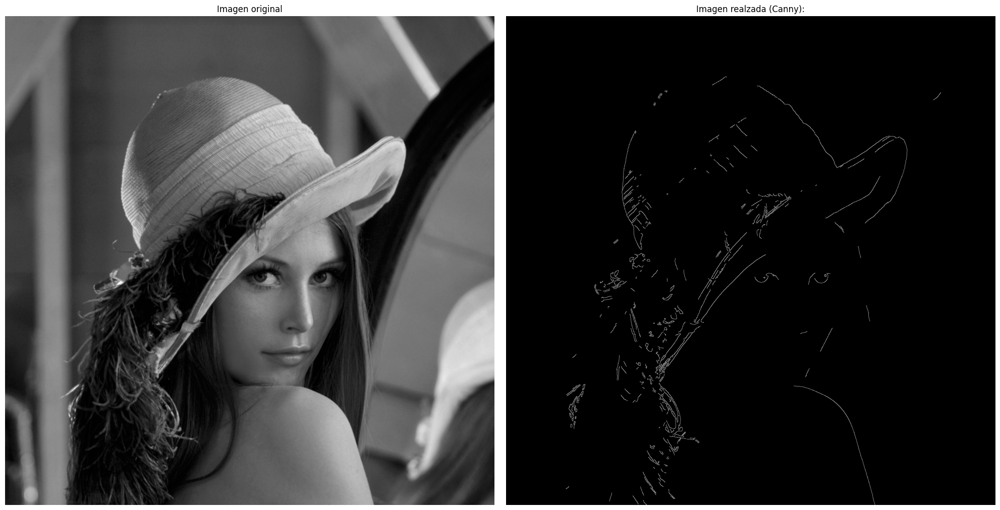

In [20]:
canny = cv2.Canny(img, 100, 200) # (imagen, umbral1, umbral2)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img, cmap='gray')
axs[0].set_title('Imagen original')
axs[0].axis('off')
axs[1].imshow(canny, cmap='gray')
axs[1].set_title('Imagen realzada (Canny):')
axs[1].axis('off')

plt.tight_layout()
plt.show()